In [1]:
#merge old_annotations & new_annotations

In [1]:
#Import dependent modules
import matplotlib.pyplot as plt
import numpy as np
import os, sys, cv2
import random
import json
import math
%matplotlib inline

In [2]:
#Load necessary data

#There are four kinds of label in CalTech Pedestrian data set
label_set = {'person', 'people', 'person-fa', 'person?'}  

#Load the ground truth annotation. You shold specify the file path of json ground truth
old_anno_path = "/root/data/data/caltech-pedestrian-dataset-converter/data/annotations.json"
new_anno_path = "/root/data/data/caltech-pedestrian-dataset-converter/data/new_anno_10x.json"
old_annotation = json.load(open(old_anno_path))
new_annotation = json.load(open(new_anno_path))

In [3]:
def get_frames(gt_annotation,box_filter = None):

    target_frames = []
    for set_num, set_annotation in gt_annotation.items():
        for v_num, v_annotation in set_annotation.items():
            for frame_num, boxes in v_annotation["frames"].items():
                filtered_box = [box for box in boxes if box_filter is None or box_filter(box)]
                
                #Only the the frames contain valid boxes are returned
                if len(filtered_box) > 0:
                    frame_name = "{}_{}_{}.jpg".format(set_num, v_num, frame_num)
                    target_frames.append((frame_name, filtered_box))
                      
    return target_frames
def get_boxes(gt_annotation, frame_name):
    set_num, v_num, frame_num = frame_name[:-4].split("_")
    if frame_num not in gt_annotation[set_num][v_num]["frames"].keys():
        return []
    return gt_annotation[set_num][v_num]["frames"][frame_num]

In [4]:
def overlap(old_boxes,new_x,new_y,new_box_area,new_xbound,new_ybound):
    for box in old_boxes:
        box_area = box['pos'][2] * box['pos'][3]
        new_mean = [new_x[0] + new_xbound / 2,new_y[0] + new_ybound / 2]
        box_mean = [box['pos'][0] + box['pos'][2] / 2,box['pos'][1] + box['pos'][3] / 2]
        dist = math.sqrt((new_mean[0] - box_mean[0])**2 + (new_mean[1] - box_mean[1])**2)
        if (dist < math.sqrt(box['pos'][2]**2 + box['pos'][3]**2) / 10) and \
        (abs(new_mean[0] - box_mean[0]) <= box['pos'][2] / 5 or abs(new_mean[1] - box_mean[1]) <= box['pos'][3] / 5) \
        and new_box_area / box_area > 0.65:
            return box
    return {}

In [5]:
def get_overlap_area(box_a, box_b):
    x1_a, y1_a, width_a, height_a = box_a
    x1_b, y1_b, width_b, height_b = box_b

    x2_a = x1_a + width_a
    y2_a = y1_a + height_a
    x2_b = x1_b + width_b
    y2_b = y1_b + height_b

    #get the width and height of overlap rectangle
    overlap_width =  min(x2_a, x2_b) - max(x1_a, x1_b) 
    overlap_height = min(y2_a, y2_b) - max(y1_a, y1_b) 

    #If the width or height of overlap rectangle is negative, it implies that two rectangles does not overlap.
    if overlap_width > 0 and overlap_height > 0:
        return overlap_width * overlap_height
    else:
        return 0
  
def get_IOU(box_a, box_b):
    overlap_area = get_overlap_area(box_a, box_b)
    
    #Union = A + B - I(A&B)
    area_a = box_a[2] * box_a[3]
    area_b = box_b[2] * box_b[3]
    union_area = area_a + area_b - overlap_area
    
    
    if overlap_area > 0 :
        return overlap_area / union_area
    else:
        return 0

In [6]:
def person_filter(box):
    return box['lbl'] == 'person'

#For boxes with a specified boundry, the default values arefrom 
def boundry_filter(box, bnds = {'xmin':5, 'ymin':5, 'xmax':635, 'ymax':475}):
    x1 = box['pos'][0]
    y1 = box['pos'][1]
    width = box['pos'][2]
    height = box['pos'][3]
    x2 = x1 + width
    y2 = y1 + height
    
    validity =  x1 >= bnds['xmin'] and \
                x2 <= bnds['xmax'] and \
                y1 >= bnds['ymin'] and \
                y2 <= bnds['ymax'] 
                
    return validity
    
#For boxes higher than a speifcied height
def height_filter(box, height_range = {'min':50, 'max': float('inf')}):
    height = box['pos'][3]
    validity = height >= height_range['min'] and \
               height < height_range['max']
    return validity

#For boxes more visible than a speifcied range
def visibility_filter(box, visible_range = {'min': 0.65, 'max': float('inf')}):
    occluded = box['occl']
    
    #A dirty condition to deal with the ill-formatted data.
    if occluded == 0 or \
       not hasattr(box['posv'], '__iter__') or \
       all([v==0 for v in box['posv']]):
           
        visiable_ratio = 1
    
    else:
        width = box['pos'][2]
        height = box['pos'][3]
        area = width * height   
           
        visible_width = box['posv'][2]
        visible_height = box['posv'][3]
        visible_area = visible_width * visible_height
           
        visiable_ratio = visible_area / area
           
           
           
    validity = visiable_ratio  >= visible_range['min'] and \
           visiable_ratio  <= visible_range['max']
           
    return validity

        
                                              
                                                                    
                                        
    height = box['pos'][3]
    validity = height >= height_range['min'] and \
               height < height_range['max']
    return validity
    

            

def reasonable_filter(box):
    validity = person_filter(box) and\
               boundry_filter(box) and\
               height_filter(box) and \
               visibility_filter(box)
           
    return validity


In [18]:
#A function that renders the image with bounding boxes
def render_frame(frame_name, boxes, compare_boxes,show):
    #You probably need to change the file path.
    images_path = "/root/data/data/caltech-pedestrian-dataset-converter/data/images"
    
    frame_path = os.path.join(images_path, frame_name)
    im = cv2.imread(frame_path)[:, :, (2, 1, 0)]
    fig, ax = plt.subplots(figsize=(12, 12))
    ax.imshow(im, aspect='equal')
    
    label_to_color = {"people": "red", "person": "green", "person-fa": "blue", "person?": "yellow","ignore" : "orange"}
    
    if show == "show merge":
        for box in compare_boxes:
            box['replace'] = 0

        for box in boxes:
            x = [0,0,0,0]
            y = [0,0,0,0]
            x[0] = box['pos'][0]
            y[0] = box['pos'][1]
            width = box['pos'][2]
            length = box['pos'][3]
            (x[1],y[1]) = (x[0],y[0] + length)
            (x[2],y[2]) = (x[0] + width,y[0] + length)
            (x[3],y[3]) = (x[0] + width,y[0])
            area = width * length
            """    correspond_box = overlap(compare_boxes,x,y,area,width,length)
            if correspond_box != {}:
                print "find corresponding box!"
                if correspond_box['posv'] != [0,0,0,0]:
                    print "changing posv"
                if correspond_box['lbl'] != "person":
                    box['lbl'] = correspond_box['lbl']
                rectangle = plt.Rectangle((correspond_box['pos'][0],correspond_box['pos'][1]), correspond_box['pos'][2],correspond_box['pos'][3],\
                                          fill=False, edgecolor="yellow", linewidth=2.0, linestyle='dashed')
                ax.add_patch(rectangle)

            
            #print "box",box['posv']
            label = box['lbl']
            color = label_to_color[label]
            rectangle = plt.Rectangle((x[0],y[0]), width,length, fill=False, edgecolor=color, linewidth=1.5)
            ax.add_patch(rectangle)
            ax.text(x[0], y[0] - 2, label,bbox=dict(facecolor=color, alpha=0.5),fontsize=14, color='white')  """
            res = {}
            print type(compare_boxes)
            for i in range(0,len(compare_boxes)):
                res[i] = get_IOU(box['pos'],compare_boxes[i]['pos'])
            Res = sorted(res.iteritems(),key=lambda d:d[1],reverse=True)
            print Res
            if len(Res) > 0:
                index,overlap = Res[0]
                correspond_box = compare_boxes[index]
                if correspond_box['lbl'] == 'people':
                    box['lbl'] = correspond_box['lbl']
                #print correspond_box
                rectangle = plt.Rectangle((correspond_box['pos'][0],correspond_box['pos'][1]), correspond_box['pos'][2],correspond_box['pos'][3],\
                                      fill=False, edgecolor="yellow", linewidth=2.0, linestyle='dashed')
                ax.add_patch(rectangle)            
            label = box['lbl']
            color = label_to_color[label]
            rectangle = plt.Rectangle((x[0],y[0]), width,length, fill=False, edgecolor=color, linewidth=1.5)
            ax.add_patch(rectangle)
            ax.text(x[0], y[0] - 2, label,
                    bbox=dict(facecolor=color, alpha=0.5),fontsize=14, color='white')
            

    
    else:
        
        for box in compare_boxes:
            #print "box",box
            x1 = box['pos'][0]
            y1 = box['pos'][1]
            width = box['pos'][2]
            length = box['pos'][3]
            label = box['lbl']
            color = label_to_color[label]
            #color = "green"
            rectangle = plt.Rectangle((x1,y1), width,length, fill=False, edgecolor=color, linewidth=1.5, \
                                      linestyle='dashed')
            ax.add_patch(rectangle)
            ax.text(x1, y1 - 2, label,
                    bbox=dict(facecolor=color, alpha=0.5),
                    fontsize=14, color='white')        
            
    
    ax.set_title(frame_name)  
    plt.axis('off')
    plt.tight_layout()
    plt.draw()

In [19]:
#Apply the specified box_filter and verify it by rendering N images with the filtered bounding boxes
#A comparing filter can also be applied. The boxes from the comparing filter are dotted lines.
def verify_annotations(N,old_anno,new_anno,box_filter):
    old_frames = get_frames(new_anno,None)
    new_frames = get_frames(new_anno,box_filter)
    old_bbox_count = 0
    new_bbox_count = 0
    for _, bboxes in old_frames:
        old_bbox_count += len(bboxes)
    for _, bboxes in new_frames:
        new_bbox_count += len(bboxes)
        
    
    
    print("Old:{} frames and {} bbox".format(len(old_frames), old_bbox_count))
    print("New:{} frames and {} bbox".format(len(new_frames), new_bbox_count))
    sampled_indices =  random.sample(range(len(new_frames)) ,N)

    #Render the selected images
    for sampled_index in sampled_indices :
        frame_name, boxes = new_frames[sampled_index]
        print frame_name
        compare_boxes = get_boxes(old_anno,frame_name)
        #print compare_boxes
        #print boxes
        render_frame(frame_name, boxes, compare_boxes,"show merge")
        render_frame(frame_name,boxes,compare_boxes,"show old")

Old:22356 frames and 64063 bbox
New:12184 frames and 27445 bbox
set02_V011_554.jpg
<type 'list'>
[(0, 0.9750074257840373), (1, 0)]
set00_V010_287.jpg
<type 'list'>
[(1, 0.6607471226848634), (0, 0), (2, 0)]
<type 'list'>
[(2, 0.957753717036248), (0, 0), (1, 0)]
set00_V009_143.jpg
<type 'list'>
[(1, 0.8469387796979302), (0, 0), (2, 0), (3, 0)]
<type 'list'>
[(2, 0.9684096485517829), (1, 0.0319986429759088), (0, 0), (3, 0)]
set04_V001_83.jpg
<type 'list'>
[(0, 0.34528445010649345)]
set01_V000_596.jpg
<type 'list'>
[(0, 0.7418429994458462), (2, 0.03016133693927409), (4, 0.027078146293387007), (1, 0), (3, 0)]
<type 'list'>
[(2, 0.7803959985102626), (0, 0.16923397336091875), (1, 0), (3, 0), (4, 0)]
<type 'list'>
[(4, 0.7703228222615467), (0, 0), (1, 0), (2, 0), (3, 0)]
set00_V003_395.jpg
<type 'list'>
[(0, 0.9868735526707072)]
set00_V007_668.jpg
<type 'list'>
[(3, 0.6856802250149693), (2, 0.1397569319994306), (0, 0), (1, 0), (4, 0)]
set00_V007_1313.jpg
<type 'list'>
[(0, 0.7272576471999334),

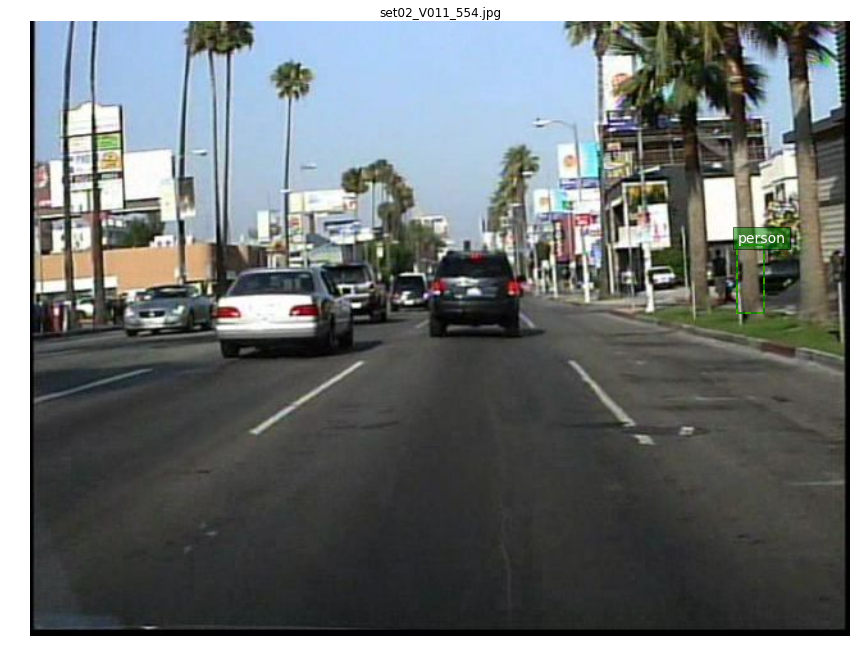

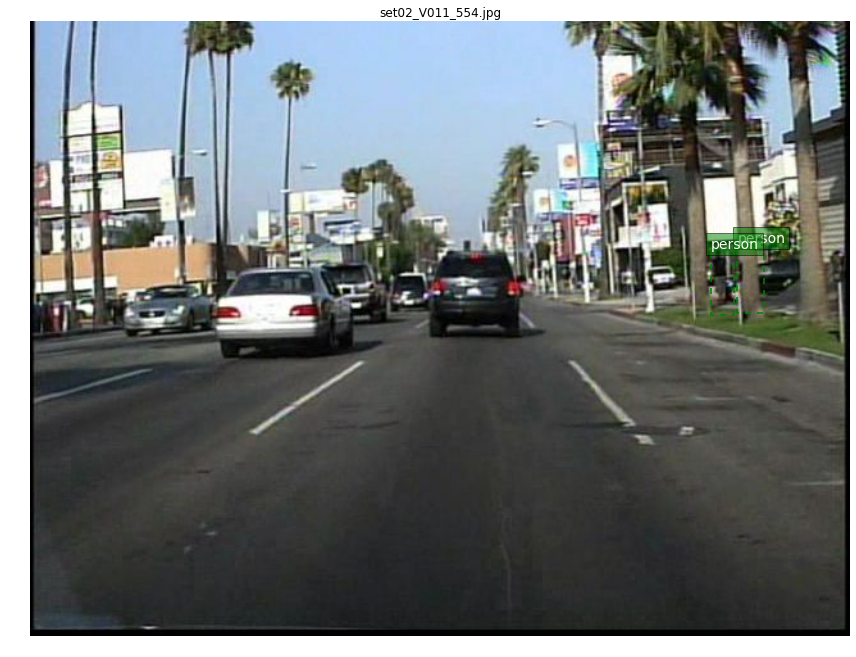

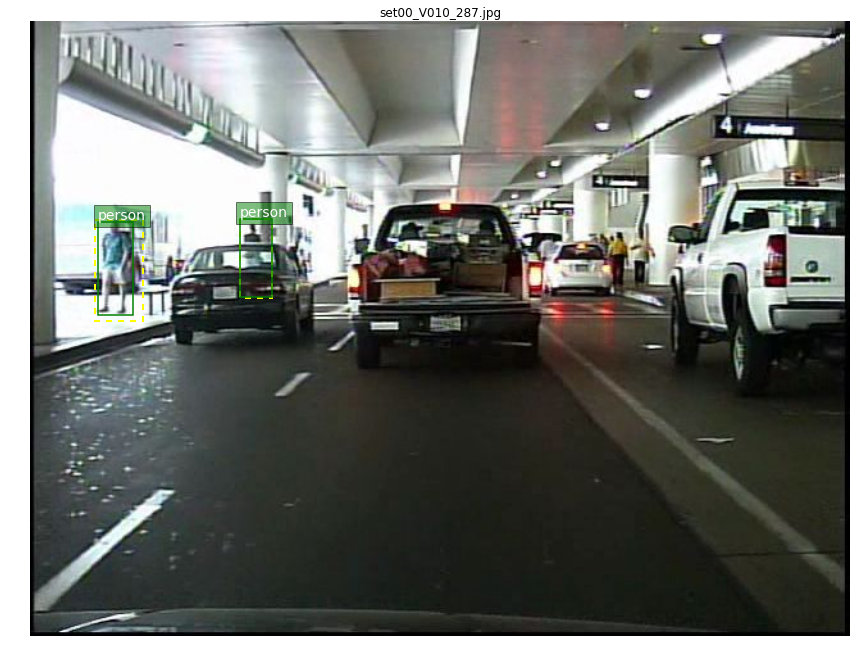

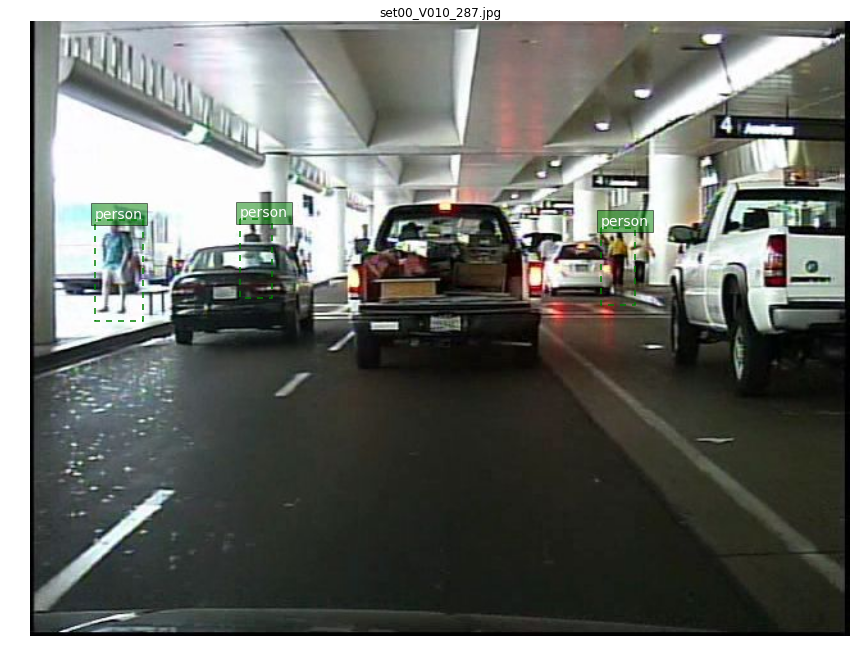

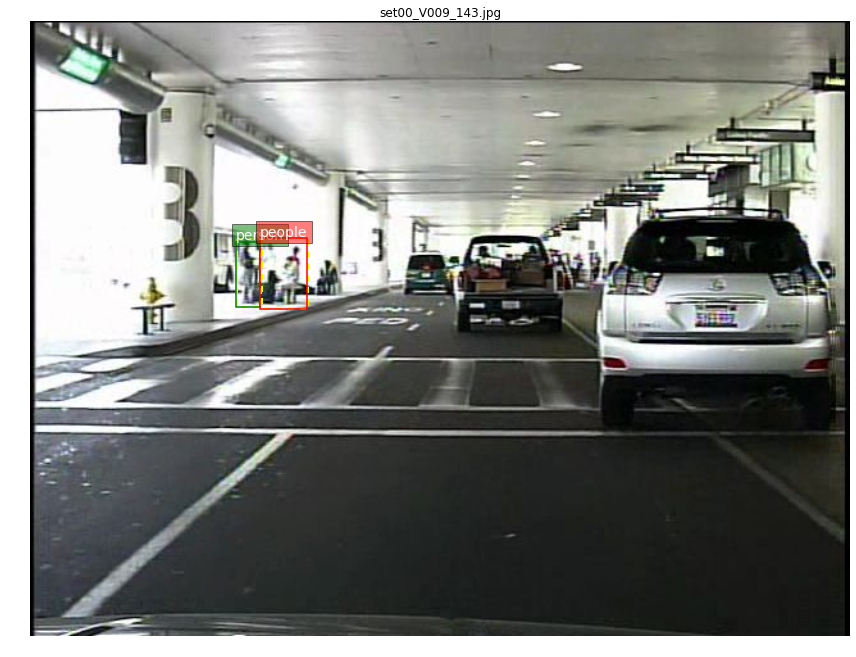

...

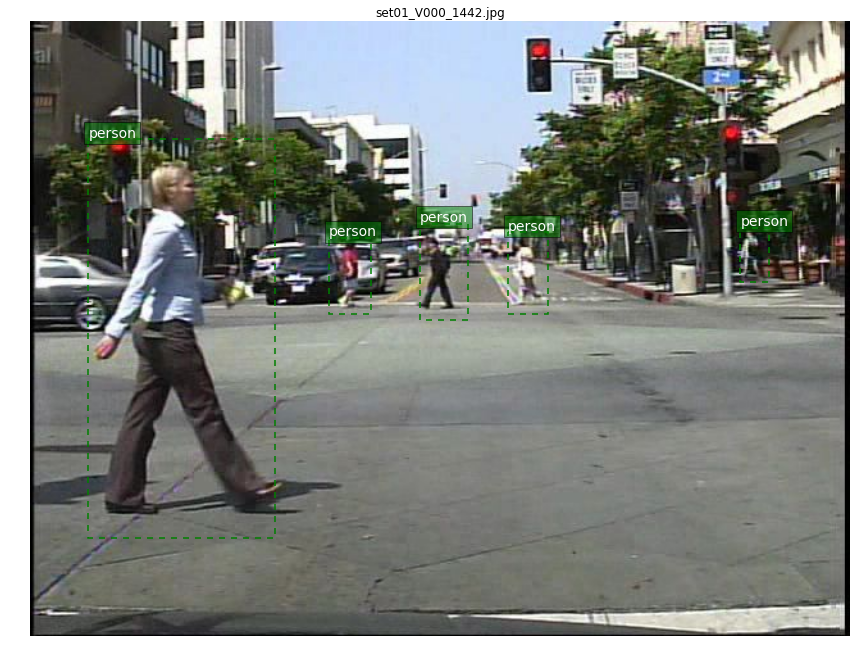

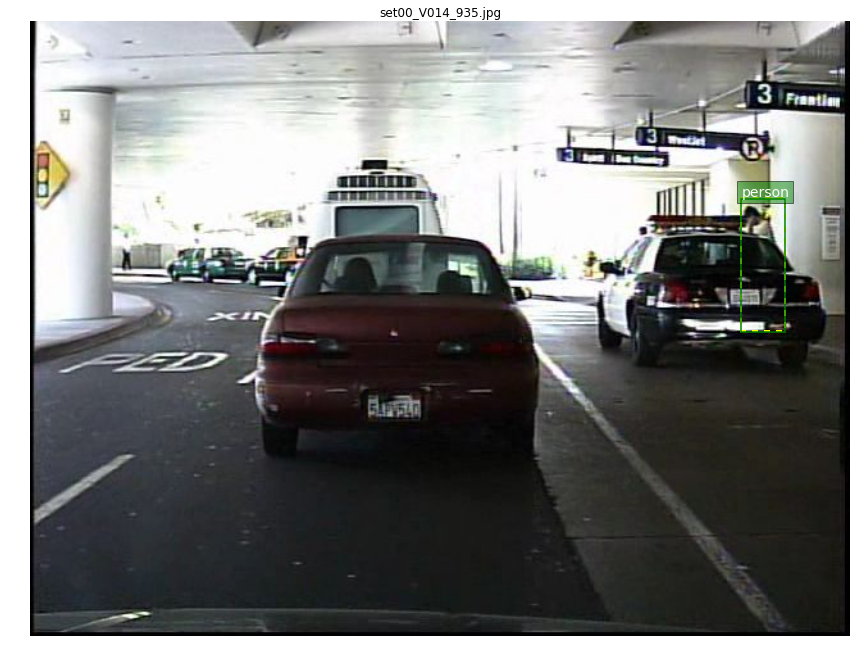

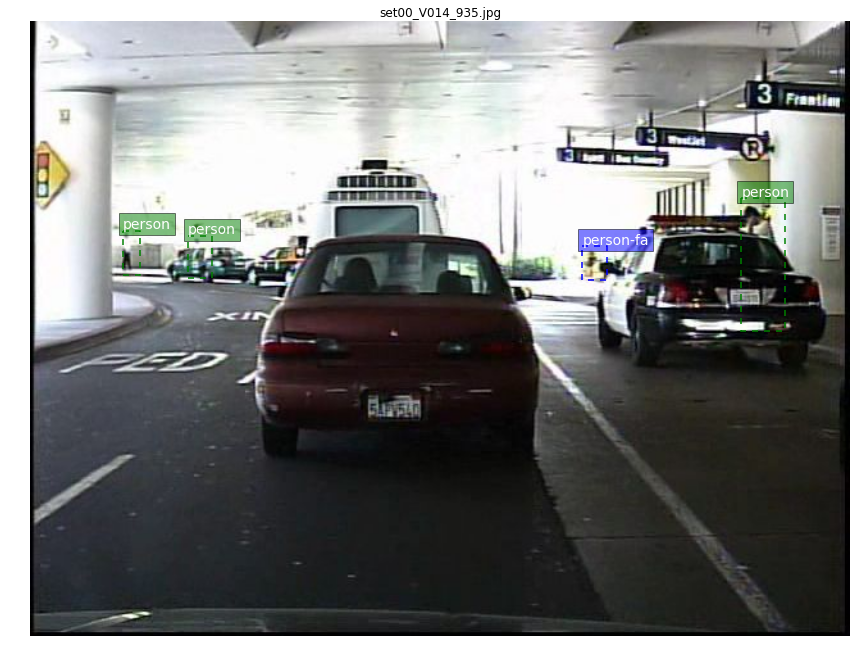

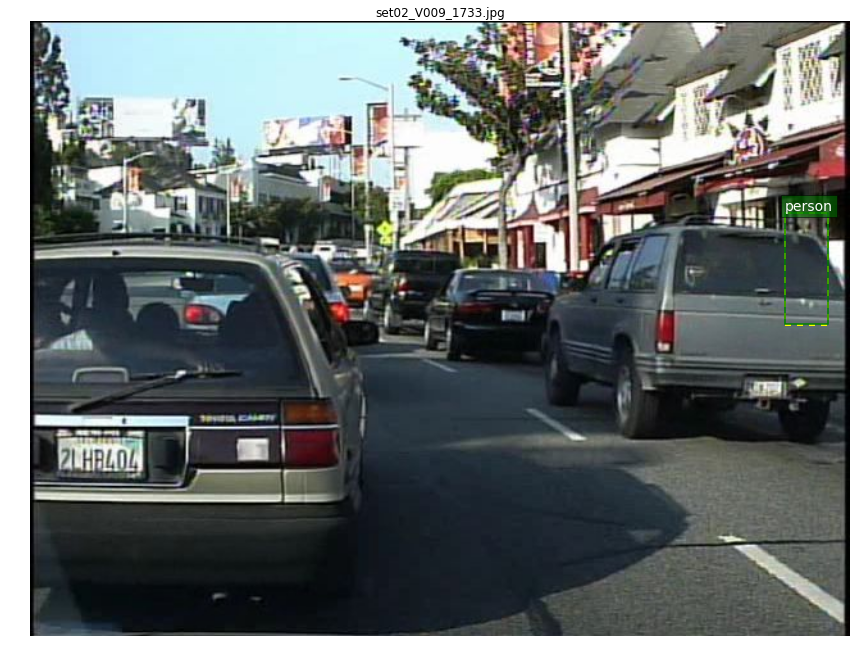

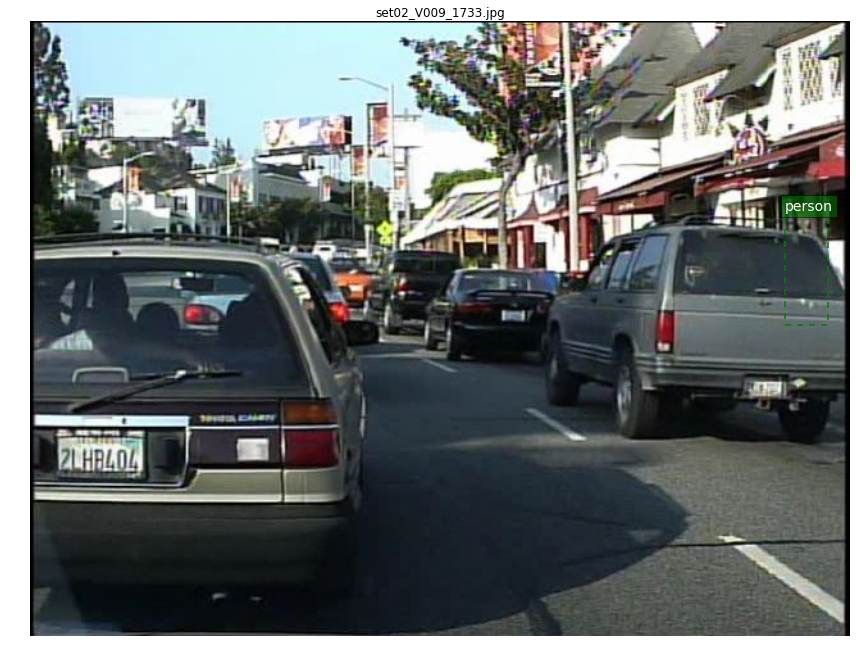

In [20]:
verify_annotations(15,old_annotation,new_annotation,reasonable_filter)